# Keyboard Optimization using Python
`- Siva Sundar, EE23B151`

In the following code, we can see the code taking a layout (By default, QWERTY) and tries to find the optimized layout (optimized in the sense, a keyboard with least travel distance). For this, the code does the following steps:

1. Takes a string as user input.

2. For this string, find the highly frequent keys and the top 8 of these keys will be chosen as the new home row keys.

(Because most frequent keys provide higher distance, making them home row keys causes their contribution to distance as 0. This helps in narrowing down the cases SA provides to give better optimized layout)

3. Next, we use Simulated Annealing (SA) which places the keys (other than home keys) in such a way which optimizes total distance.

4. The changes in keyboard layout done by SA during each of its iterations are shown as animation at the end of the code.

Documentation for each function is in its definition, markdown comments are provided which will guide you through the jupyter notebook.

## How to run the notebook?

1. Download the zip file and extract notebook file and layout files. Ensure all of these files are in the same directory.
2. Press `Run All` in the notebook. It will prompt for string input once.
3. If you want to change the initial layout to some layout other than QWERTY, inside `main program` change index used inside `layouts`.
3. Comments are provided in the notebook to guide you through the code.

#### Libraries used in the code:

In [1]:
import matplotlib.pyplot as plt                 # For plotting
import math                                     # math.dist is used for distance calculation
from matplotlib.animation import FuncAnimation  # For animation
import matplotlib.gridspec as gridspec          # For better placement of axes
from IPython.display import HTML                # Converting plots to animation
import numpy as np                              # For heatmap weight creation
from matplotlib.colors import (                 # For using different named colors and creating new color maps
    Normalize,
    LinearSegmentedColormap,
)  
from matplotlib.patches import Rectangle        # For drawing rectangles in plot
import random                                   # To introduce randomness (eg: random numbers)
import copy                                     # Used primarily for creating DEEP-COPIES of dictionaries

Importing the keyboard layout files.

In [2]:
import qwerty_layout as l
import dvorak_layout as m
import colemak_layout as n

layouts = [l, m, n]
layout_names = ["QWERTY", "DVORAK", "COLEMAK"]

Defining `plot_keyboard` function which will take in a layout and axis to plots the given keyboard layout in the axis.

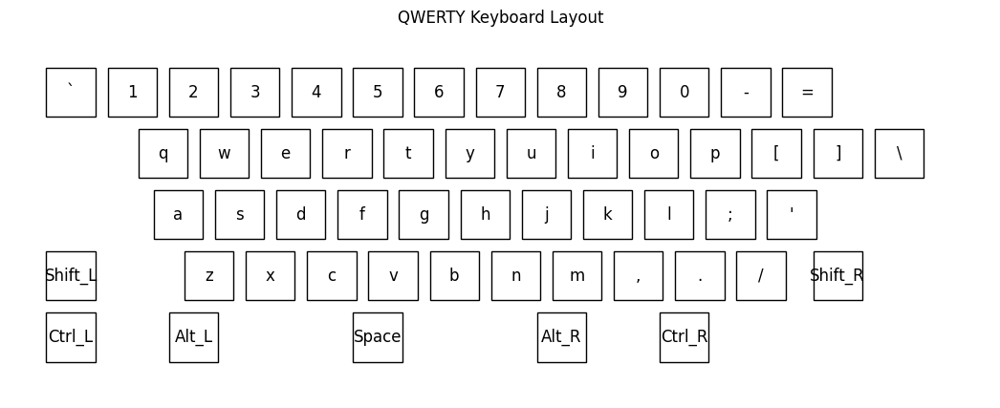

In [3]:
def plot_keyboard(keys, ax):
    for key, data in keys.items():
        x, y = data["pos"]
        rect = Rectangle((x - 0.4, y - 0.4), 0.8, 0.8, fill=False)
        ax.add_patch(rect)
        ax.text(x, y, key, ha="center", va="center", fontsize=12)

    ax.set_xlim(-1, 15)
    ax.set_ylim(-1, 5)
    ax.set_aspect("equal", adjustable="box")
    ax.axis("off")


# Creating a figure and axis for ploting the layout
fig, ax = plt.subplots(figsize=(20, 5))
ax.set_title(f"{layout_names[0]} Keyboard Layout")

layout = layouts[0]  # QWERTY layout
plot_keyboard(layout.keys, ax)

The following set of functions are the same as in Assignment 4, which were used for: 
- converting string to corresponding key presses
- finding key press locations
- finding the key frequency
- calculating total distance and
- plotting the keyboard with a frequency heatmap.

Some of these have slight changes.

In [4]:
def plotter(key_press, key_freq, key_press_loc, layout, ax):
    """Function which handles plotting the keyboard (made using Voronoi diagram)
    as well as the heatmap over the keyboard."""

    # Get key locations and labels for Voronoi
    plot_keyboard(layout, ax)
    # Generate the space in which the blobs will live
    xmin, xmax, ymin, ymax = (-1, 15, -1, 15)
    n_bins = 1000
    xx = np.linspace(xmin, xmax, n_bins)
    yy = np.linspace(ymin, ymax, n_bins)

    # Generate the blobs. The range of the values is roughly -.0002 to .0002
    var = 0.2

    # Storing weights
    weights = np.zeros((n_bins, n_bins))
    for i in range(len(key_press)):
        key = key_press[i]
        x, y = key_press_loc[i]
        freq = key_freq[key]

        gauss_keys_x = normal_pdf(xx, x, var)
        gauss_keys_y = normal_pdf(yy, y, var)

        weights += freq * (np.outer(gauss_keys_y, gauss_keys_x))

    # Making my own color map
    colors = [
        (0.0, "white"),
        (0.2, "dodgerblue"),
        (0.5, "cyan"),
        (0.6, "greenyellow"),
        (0.7, "yellow"),
        (1, "coral"),
    ]
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors)

    vmax = np.abs(weights).max()
    imshow_kwargs = {
        "vmax": vmax,
        "vmin": 0,
        "cmap": cmap,
        "extent": (xmin, xmax, ymin, ymax),
        "origin": "lower",
    }

    # Create an alpha channel based on weight values
    # Any value whose absolute value is > .0001 will have zero transparency
    alphas = Normalize(0, 0.3, clip=True)(np.abs(weights))
    alphas = np.clip(alphas, 0.4, 1)  # alpha value clipped at the bottom at .4

    # Create the figure and image
    ax.imshow(weights, alpha=alphas, **imshow_kwargs)

    # Set limits for the axes
    ax.set_xlim(-1, 14)
    ax.set_ylim(-1, 5)

    return ax


def normal_pdf(x, mean, var):
    return np.exp(-((x - mean) ** 2) / (2 * var))


def key_count(key_press):
    """Returns the frequency dictionary with key-value pairs as key label and its frequency"""
    key_freq = {}
    for key in key_press:
        if key not in key_freq:
            key_freq[key] = 1
        else:
            key_freq[key] += 1
    return key_freq


def find_key_press(string, layout_keys, layout_chars):
    """Used to find the key presses involved while typing the string, given a layout is followed."""
    key_press = []
    key_press_loc = []
    keys = layout_keys
    chars = layout_chars

    for letter in string:
        if (
            letter in chars and letter not in keys and letter != " "
        ):  # The key needs shift
            shift, lower_key = chars[letter]

            shift_pos = keys[shift]["pos"]
            lower_pos = keys[lower_key]["pos"]

            key_press += [shift, lower_key]
            key_press_loc += [shift_pos, lower_pos]

        elif letter == " ":
            space = chars[letter][0]
            space_pos = keys[space]["pos"]
            key_press += [space]
            key_press_loc += [space_pos]

        else:
            try:
                pos = keys[letter]["pos"]
            except KeyError:
                raise KeyError(f"The letter '{letter}' is not in layout")
            key_press += [letter]
            key_press_loc += [pos]

    return key_press, key_press_loc


def calculate_distance(layout_keys, key_freq):
    # Iterate over the key_freq dictionary to find distance for each key
    total_dist = 0

    for key in key_freq:
        freq = key_freq[key]
        key_pos, home_key = layout_keys[key]["pos"], layout_keys[key]["start"]
        home_pos = layout_keys[home_key]["pos"]
        key_dist = freq * math.dist(key_pos, home_pos)
        total_dist += key_dist

    return total_dist

Functions for SA:

Both are functions from Prof's SA simulator code, I made changes to them for this code's purpose.

In [5]:
# Generate a neighbour solution by swapping two keys (except home keys)
def get_neighbour(route, home_row):             # Route will be the key positions (keys dict)
    new_route = copy.deepcopy(route)

    # Keys to exclude during swap
    exclude_keys = home_row
    # Filter the dictionary keys
    filtered_keys = [key for key in route if key not in exclude_keys]

    # Get 2 random keys
    i, j = random.sample(filtered_keys, 2)

    new_route[i], new_route[j] = new_route[j], new_route[i]
    return new_route

In [6]:
# Simulated annealing algorithm
def simulated_annealing(current_route, cities, temp, home_row):
    current_distance = calculate_distance(      # Cities are the object (letter:frequency)
        current_route, cities
    )  
    # Route is the layout
    best_route = copy.deepcopy(current_route)
    best_distance = current_distance

    neighbour_route    = get_neighbour(current_route, home_row)            # Shuffling current layout
    neighbour_distance = calculate_distance(neighbour_route, cities)       # Distance for this layout

    p = np.exp((current_distance - neighbour_distance) / temp)
    if neighbour_distance < current_distance or random.random() < p:
        current_route = neighbour_route
        current_distance = neighbour_distance

        if current_distance < best_distance:
            best_route = copy.deepcopy(current_route)
            best_distance = current_distance

    return current_route, best_route, best_distance, current_distance

### Main program

Here, the code takes in a string input (I gave the assignment description as string), initializes parameters with fixed values for SA, and chose layout as QWERTY.

In [7]:
string = input("Enter a string: ")     # User input

# Params for SA
initial_temp = 100
cooling_rate = 0.995
num_iterations = 200

# Choosing initial layout
layout = layouts[0]  # Index 0: QWERTY, 1: DVORAK, 2: COLEMAK
keys = copy.deepcopy(layout.keys)
chars = layout.characters

Here, we find the new layout which has the home rows as the highest frequency keys. This is done by the `new_home_row` function.

In [8]:
def find_root(mapping, key):
    """Finding the root value in a dictionary
    for example, if dict = {a:2, b:a, d:b}
                 then find_root(dict, d) = dict[d]
                                         = dict[dict[b]]
                                         = dict[dict[dict[a]]]
                                         = a"""

    # Recursively follow the chain until you find the last root
    while key in mapping:
        key = mapping[key]
    return key


def animate_swap(frame, mapping, layout_frames, ax):
    """Function for animation showing how new_home_row function changes home row keys."""
    # Get current swap information
    home_key = list(mapping)[frame]
    new_key = mapping[home_key]

    ax.clear()  # Clearing axis for new plot
    ax.set_title(f"Swapping {home_key} with {new_key}", fontsize=14)
    plot_keyboard(layout_frames[frame], ax)  # Plot the updated layout


def new_home_row(layout_keys, key_freq):
    """The function finds the highly frequeny keys from key_freq
    and makes a new layout with these keys as the home row keys."""

    home_row = []  # List storing current home keys
    new_layout_keys = copy.deepcopy(
        layout_keys
    )  # Initializing new layout with a deep-copy of current layout

    # Find the home keys of current layout
    for key in layout_keys:
        home_key = layout_keys[key]["start"]
        if home_key not in home_row:
            home_row.append(home_key)

    # Get the top 8 keys with highest freq
    high_freq_keys = sorted(key_freq, key=key_freq.get, reverse=True)[:8]

    # Mapping the high freqency keys to corresponding home key
    # Mapping => (current home key) : (high frequency key)
    mapping = dict(zip(home_row, home_row))  # Initially
    new_mapping = dict(
        zip(home_row, high_freq_keys)
    )  # Mapping with high frequency keys (may contain <= 8 maps)
    mapping.update(new_mapping)  # Updating the map with the new map

    print(f"Mapping: {mapping}")

    # Swapping start positon of all keys in current layout as per new home row
    for key in new_layout_keys:
        start_key = new_layout_keys[key][
            "start"
        ]  # If key had initially this start_key...
        new_key = mapping[start_key]  # ...replace it using the mapping.
        if key in high_freq_keys:  # If key is one of the high frequency key...
            new_layout_keys[key][
                "start"
            ] = key  # ...its starting key is itself. (It is the home key now)

    fig, ax = plt.subplots(figsize=(20, 5))

    # The following algorithm helps to interchange the 'old home row' to the 'new home row'
    shift = {}                              # Used to find which key currently sits at home key's position
    layout_frames = []                      # For animation purposes
    for home_key in mapping:
        new_key = mapping[home_key]         # New home key corresponding to previous home key
        temp = new_layout_keys[new_key][    # Temporaryly storing position of this key (in the new layout)
            "pos"
        ]                            
        new_layout_keys[new_key]["pos"] = layout_keys[home_key][
            "pos"
        ]                                   # Change position of new home key with old home key
        if (                                # "If home key in d" implies the old home key got shifted during this loop
            home_key in shift
        ):  
            root_key = find_root(           # Find which home key is currently residing at old home key's position
                shift, home_key
            )  
            new_layout_keys[root_key]["pos"] = temp     # Change this home key with new key's previous position
            if new_key in mapping:
                shift[new_key] = home_key 

        elif new_key in mapping:                        # If the frequent keys contain the old home key
            shift[new_key] = home_key                   # Store it in d, which implies the following...
            new_layout_keys[home_key]["pos"] = temp     # ...this key got shifted.

        else:
            new_layout_keys[home_key]["pos"] = layout_keys[new_key][    # Else, just change the old home key to new home key's old location
                "pos"
            ]  
        layout_frames.append(copy.deepcopy(new_layout_keys))

    # Create the animation using FuncAnimation
    anim = FuncAnimation(
        fig,
        animate_swap,
        frames=range(len(home_row)),
        fargs=(mapping, layout_frames, ax),
        interval=1000,
        repeat=True,  # Repeat the animation and set a 1 second interval between frames
    )

    return new_layout_keys, high_freq_keys, anim

Mapping: {'a': 'Space', 's': 't', 'd': 'e', 'f': 'o', 'j': 'a', 'k': 'i', 'l': 'n', ';': 's'}


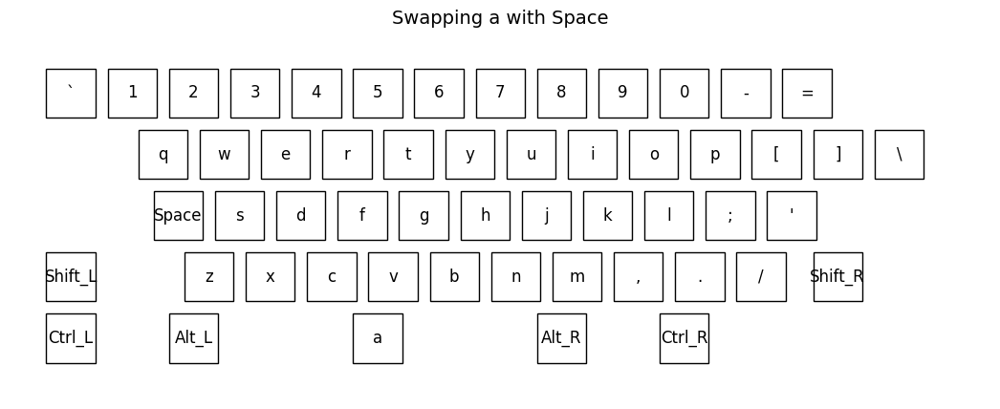

In [9]:
# Find key presses and their frequencies for calculating distance
key_press, key_press_loc = find_key_press(string, keys, chars)
key_freq = key_count(key_press)
initial_dist = calculate_distance(keys, key_freq)  # Storing distance for intial layout

# List for storing routes (possible solutions) made by SA
current_routes = []

# Generate the initial route and new home row keys
current_route, home_row, anim = new_home_row(keys, key_freq)
current_routes.append(current_route)  # Storing this layout as our first route

HTML(anim.to_jshtml())  # Animation showing how home keys are changed for new layout

The following snippet is for SA implementation to get optimized layout, and setting the plots for visualizing the final layout.

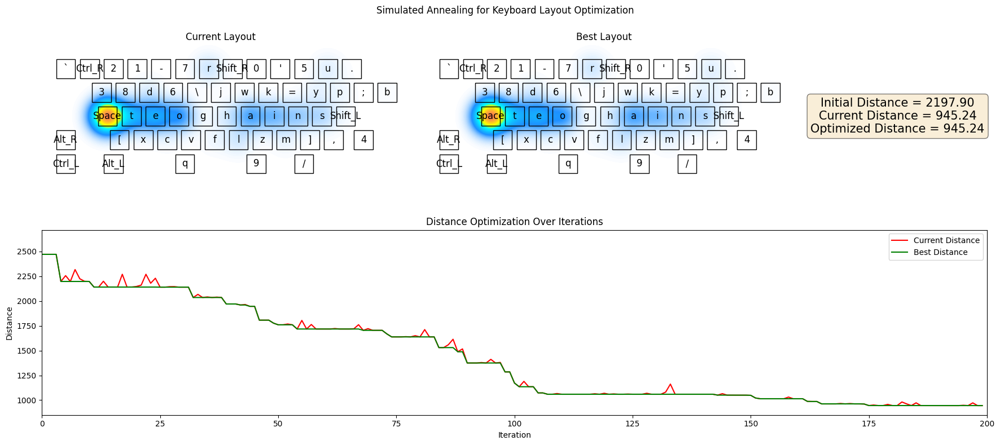

In [10]:
# Set up the figure with a grid layout using gridspec
fig = plt.figure(figsize=(18, 8))
gs = gridspec.GridSpec(2, 3, width_ratios=[2, 2, 1])  # 3 rows, 3 columns, adjust ratios

# Create subplots
ax1 = fig.add_subplot(gs[0, 0])  # Current layout (top-left)
ax2 = fig.add_subplot(gs[0, 1])  # Best layout (top-center)
ax3 = fig.add_subplot(gs[1, 0:3])  # Distance graph (bottom, spanning all columns)
ax4 = fig.add_subplot(gs[0, 2])  # Text box (right column)
fig.suptitle("Simulated Annealing for Keyboard Layout Optimization")

# Plot current layout (on ax1)
ax1 = plotter(key_press, key_freq, key_press_loc, current_route, ax1)
ax1.set_title("Current Layout")

# List for storing "best routes" made by SA
best_routes = []
best_routes.append(current_routes[0])  # Start with the initial layout as the best one
ax2 = plotter(
    key_press, key_freq, key_press_loc, best_routes[-1], ax2
)  # Plot the new best route
ax2.set_title("Best Layout")

# Distance subplot
ax3.set_xlim(0, num_iterations)
ax3.set_ylim(0, 300)  # Will dynamically update this based on actual data
ax3.set_title("Distance Optimization Over Iterations")
ax3.set_xlabel("Iteration")
ax3.set_ylabel("Distance")

# Initialize the plot lines for current and best distance
(cur_dist_line,) = ax3.plot([], [], "r-", label="Current Distance")  # Red line
(best_dist_line,) = ax3.plot([], [], "g-", label="Best Distance")  # Green line
ax3.legend()

# Initialize lists for storing distances
cur_dists = []
best_dists = []

temp = initial_temp  # Initial temperature

# Simulated annealing algorithm
for frame in range(num_iterations):
    current_route, best_route, best_dist, cur_dist = simulated_annealing(
        best_routes[-1], key_freq, temp, home_row
    )
    temp = temp * cooling_rate  # Temp decreases as a GP

    # Storing the info in the lists for each iteration
    current_routes.append(current_route)
    best_routes.append(best_route)
    cur_dists.append(cur_dist)
    best_dists.append(best_dist)

""" Plotting the final layout made by SA """

# Plot the heatmap for the last route in ax1
key_press, key_press_loc = find_key_press(string, current_route, chars)
ax1.clear()  # Clear previous frame's plot
ax1 = plotter(key_press, key_freq, key_press_loc, current_routes[-1], ax1)
ax1.set_title("Current Layout")

# Update the "final best layout" in ax2
key_press, key_press_loc = find_key_press(string, best_routes[-1], chars)
ax2.clear()  # Clear previous plot in ax2
ax2 = plotter(
    key_press, key_freq, key_press_loc, best_routes[-1], ax2
)  # Plot the new best route
ax2.set_title("Best Layout")

# Update the distance plots (ax3)
cur_dist_line.set_data(range(num_iterations), cur_dists)
best_dist_line.set_data(range(num_iterations), best_dists)

# Redraw the limits dynamically to fit new data
ax3.set_ylim(0.9 * min(cur_dists), 1.1 * max(cur_dists))  # Adjust y-limits for distance

# Create a text box in the right subplot (ax4)
ax4.clear()  # Clear any previous content
ax4.axis("off")  # Hide the axes for the text box

# Add the best distance value in ax4
best_distance_text = (
    f"Initial Distance = {initial_dist:.2f}\n"
    f"Current Distance = {cur_dists[-1]:.2f}\n"
    f"Optimized Distance = {best_dists[-1]:.2f}"
)
ax4.text(
    0.5,
    0.5,
    best_distance_text,
    transform=ax4.transAxes,
    fontsize=15,
    ha="center",
    va="center",
    bbox=dict(boxstyle="round", facecolor="wheat", alpha=0.5),
)

plt.tight_layout()
plt.show()

### Animating the above SA process

After the SA process, we now have a list of random routes made by SA and list of the distances for these layouts, list of best routes and list of the distances for these layouts. Using this, we can make an animation by plotting them in each frame. This is done by the `update()`. 

In [ ]:
# Animation update function
def update(
    frame,
    string,
    key_freq,
    best_routes,
    current_routes,
    cur_dists,
    best_dists,
    ax1,
    ax2,
    ax3,
    ax4,
    cur_dist_line,
    best_dist_line,
    chars,
):
    current_route = current_routes[frame]
    # Plot the heatmap for the current route on ax1
    key_press, key_press_loc = find_key_press(string, current_route, chars)
    ax1.clear()  # Clear previous frame's plot
    ax1 = plotter(key_press, key_freq, key_press_loc, current_route, ax1)
    ax1.set_title("Current layout")

    # Update the "best layout" plot
    key_press, key_press_loc = find_key_press(string, best_routes[frame], chars)
    ax2.clear()  # Clear previous frame's plot in ax2
    ax2 = plotter(
        key_press, key_freq, key_press_loc, best_routes[frame], ax2
    )  # Plot the new best route
    ax2.set_title("Best layout")

    # Update the distance plots
    cur_dist_line.set_data(range(frame + 1), cur_dists[: frame + 1])
    best_dist_line.set_data(range(frame + 1), best_dists[: frame + 1])

    # Redraw the y-limits dynamically to fit new data
    ax3.set_ylim(
        0.9 * min(cur_dists[: frame + 1]), 1.1 * max(cur_dists[: frame + 1])
    )  # Adjust y-limits for distance

    # Create a text box in the right subplot (ax4)
    ax4.clear()  # Clear any previous content
    ax4.axis("off")  # Hide the axes for the text box

    # Add the best distance value in ax4
    text_string = (
        f"Initial Distance = {initial_dist:.2f}\n"
        f"Current Distance = {cur_dists[frame]:.2f}\n"
        f"Optimized Distance = {best_dists[frame]:.2f}"
    )
    ax4.text(
        0.5,
        0.5,
        text_string,
        transform=ax4.transAxes,
        fontsize=15,
        ha="center",
        va="center",
        bbox=dict(boxstyle="round", facecolor="wheat", alpha=0.5),
    )

    plt.tight_layout()

    return cur_dist_line, best_dist_line

In [12]:
# Create the animation
anim = FuncAnimation(
    fig,
    update,
    frames=range(0, num_iterations, 1),
    fargs=(
        string,
        key_freq,
        best_routes,
        current_routes,
        cur_dists,
        best_dists,
        ax1,
        ax2,
        ax3,
        ax4,
        cur_dist_line,
        best_dist_line,
        chars,
    ),
    interval=50,
    blit=True,
    repeat=False,
)

# Use the HTML animation for display inside a notebook
plt.rcParams["animation.embed_limit"] = 50  # Set in megabytes (MB)
HTML(anim.to_jshtml())  # Takes about 5-6 mins to load a new animation for 2-3 sentences.

<Figure size 640x480 with 0 Axes>